In [ ]:
import os
import torch
os.environ["CUDA_VISIBLE_DEVICES"] = "2"

if torch.cuda.is_available():
    print("GPU is available.")
    print("GPU device:", torch.cuda.get_device_name(0))
else:
    print("GPU is not available.")

GPU is available.
GPU device: NVIDIA RTX A6000


In [ ]:
!nvidia-smi

Sat Sep  9 02:54:12 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.199.02   Driver Version: 470.199.02   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A6000    Off  | 00000000:3B:00.0 Off |                  Off |
|  0%   35C    P8    23W / 300W |  47980MiB / 48685MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA RTX A6000    Off  | 00000000:5E:00.0 Off |                  Off |
|  0%   

In [ ]:
import os
import glob
from IPython.display import Image, display

In [ ]:
!pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.154 🚀 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)
Setup complete ✅ (80 CPUs, 754.5 GB RAM, 1681.1/3504.2 GB disk)


In [ ]:
# Import the Path class from the pathlib module
from pathlib import Path

# Define the path to the images folder
images_folder = '/home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export'

# Create a Path object for the images folder
data_path = Path(images_folder)

In [ ]:
# List the subdirectories within the images folder
subdirectories = [item for item in data_path.iterdir() if item.is_dir()]

# Print the list of subdirectories just to be sure it works
for subdirectory in subdirectories:
    print(subdirectory.name)

valid
test
train


In [ ]:
# Define the path to the configuration file
config_file = '/home/dll/Documents/obinna/yolov5/data/data1.yaml'
print(config_file)

/home/dll/Documents/obinna/yolov5/data/data1.yaml


In [ ]:
# Open and read the YAML(Configuration) file
with open(config_file, 'r') as yaml_file:
    yaml_content = yaml_file.read()
    print(yaml_content)

train: Self Driving Car.v3-fixed-small.yolov8/export/train/images
val: Self Driving Car.v3-fixed-small.yolov8/export/valid/images
test: Self Driving Car.v3-fixed-small.yolov8/export/test/images

nc: 1
names: ['car']



In [ ]:
import os

# Specify the target directory path
target_directory = "/home/dll/Documents/obinna/yolov5/"

# Change the working directory
os.chdir(target_directory)

In [ ]:
# Train a YOLOv5 model with the specified configuration
!python train.py --data ./data/data1.yaml --epochs 100 --weights yolov5n.pt --cfg yolov5n.yaml --batch-size 50

train: weights=yolov5n.pt, cfg=yolov5n.yaml, data=./data/data1.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=50, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0

# This section shows the contents of the results folder.

In [ ]:
# Path to the results folder
results_folder = '/home/dll/Documents/obinna/yolov5/runs/train/exp'

# List the contents of the folder
contents = os.listdir(results_folder)

# Display the list of all file names
print("Contents of the results folder:")
for item in contents:
    print(item)

Contents of the results folder:
F1_curve.png
val_batch0_pred.jpg
R_curve.png
train_batch1.jpg
train_batch0.jpg
events.out.tfevents.1694224674.dll-WS-C621E-SAGE-Series.3045695.0
opt.yaml
val_batch0_labels.jpg
results.png
labels.jpg
val_batch2_labels.jpg
hyp.yaml
results.csv
val_batch2_pred.jpg
val_batch1_labels.jpg
PR_curve.png
weights
P_curve.png
val_batch1_pred.jpg
confusion_matrix.png
labels_correlogram.jpg
train_batch2.jpg


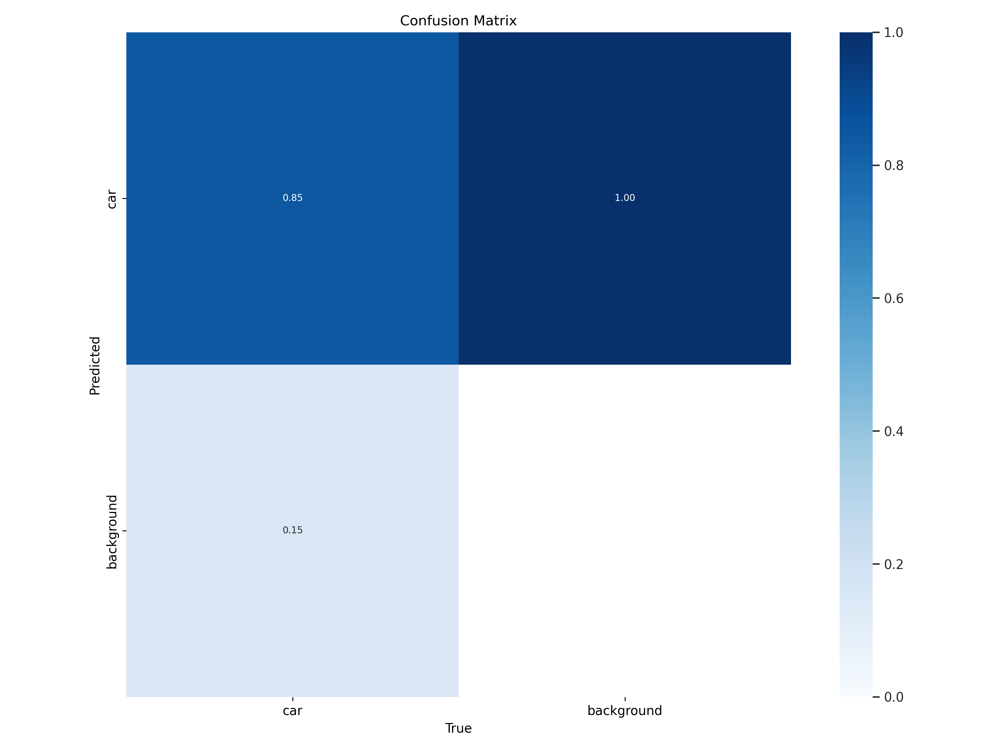

In [ ]:
from PIL import Image
from IPython.display import display

# Specify the path to the confusion matrix image
confusion_matrix_image = "confusion_matrix.png"
image_path = os.path.join(results_folder, confusion_matrix_image)

# Open and display the image
img = Image.open(image_path)
display(img)

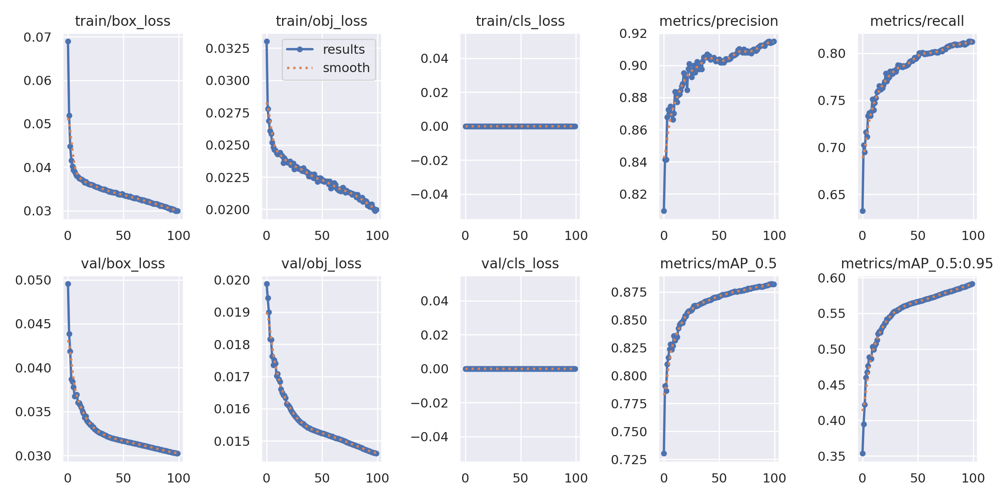

In [ ]:
#Training and Validation Loss

results = "results.png"
image_path = os.path.join(results_folder, results)
img = Image.open(image_path)
display(img)

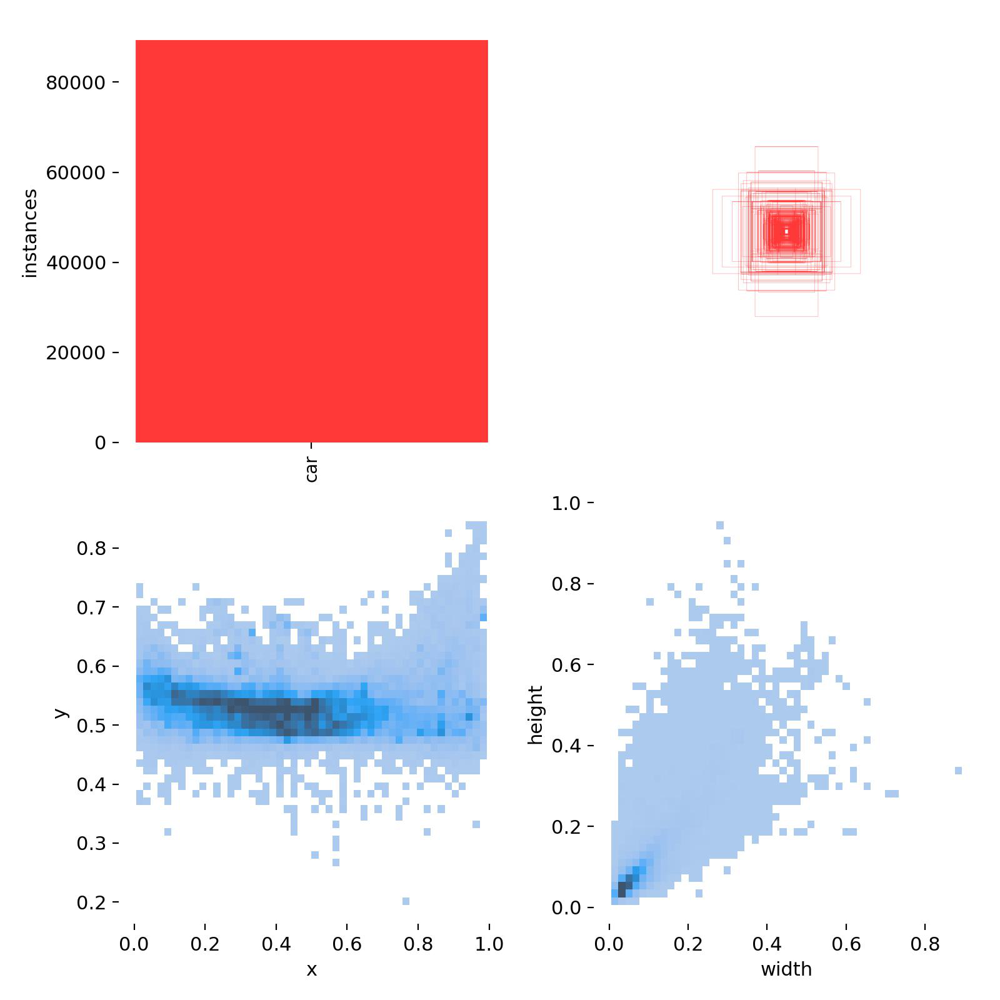

In [ ]:
#Display Labels

labels = "labels.jpg"
image_path = os.path.join(results_folder, labels)
img = Image.open(image_path)
display(img)

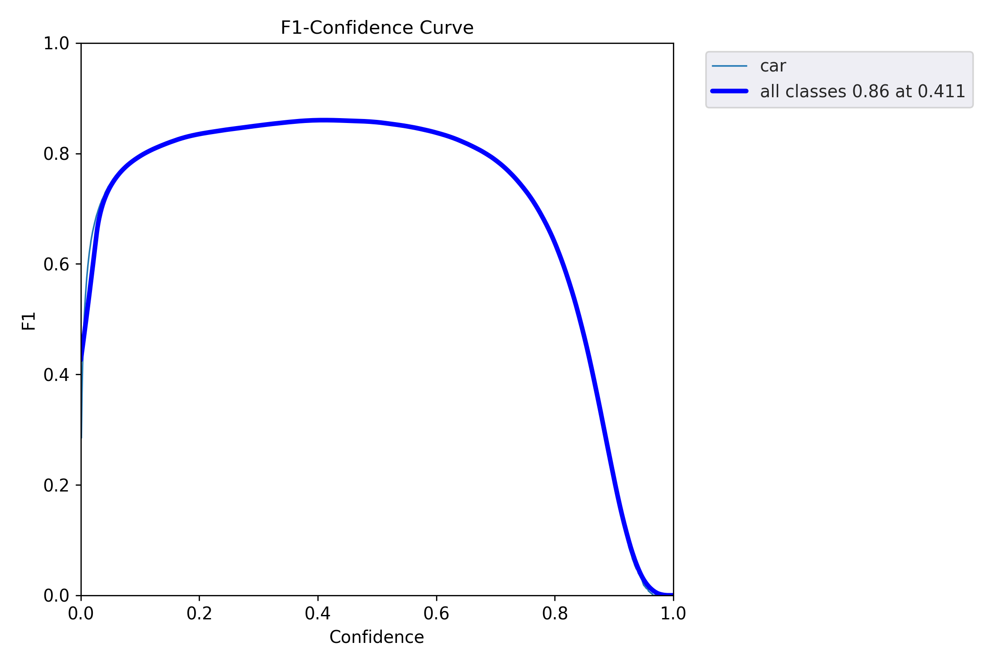

In [ ]:
#Display F1 Confidence curve

F1_curve = "F1_curve.png"
image_path = os.path.join(results_folder, F1_curve)
img = Image.open(image_path)
display(img)

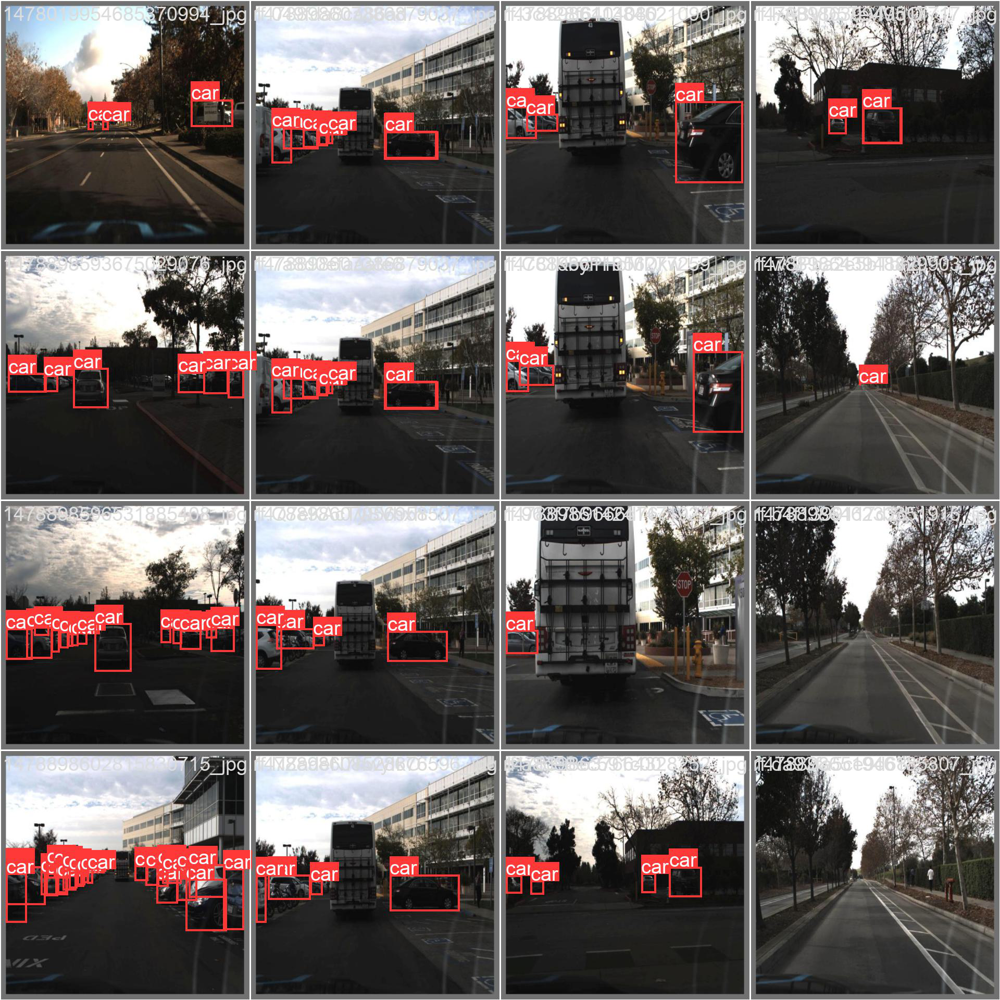

In [ ]:
#Display Validation Batch label 0

val_batch0_labels = "val_batch0_labels.jpg"
image_path = os.path.join(results_folder, val_batch0_labels)
img = Image.open(image_path)
display(img)

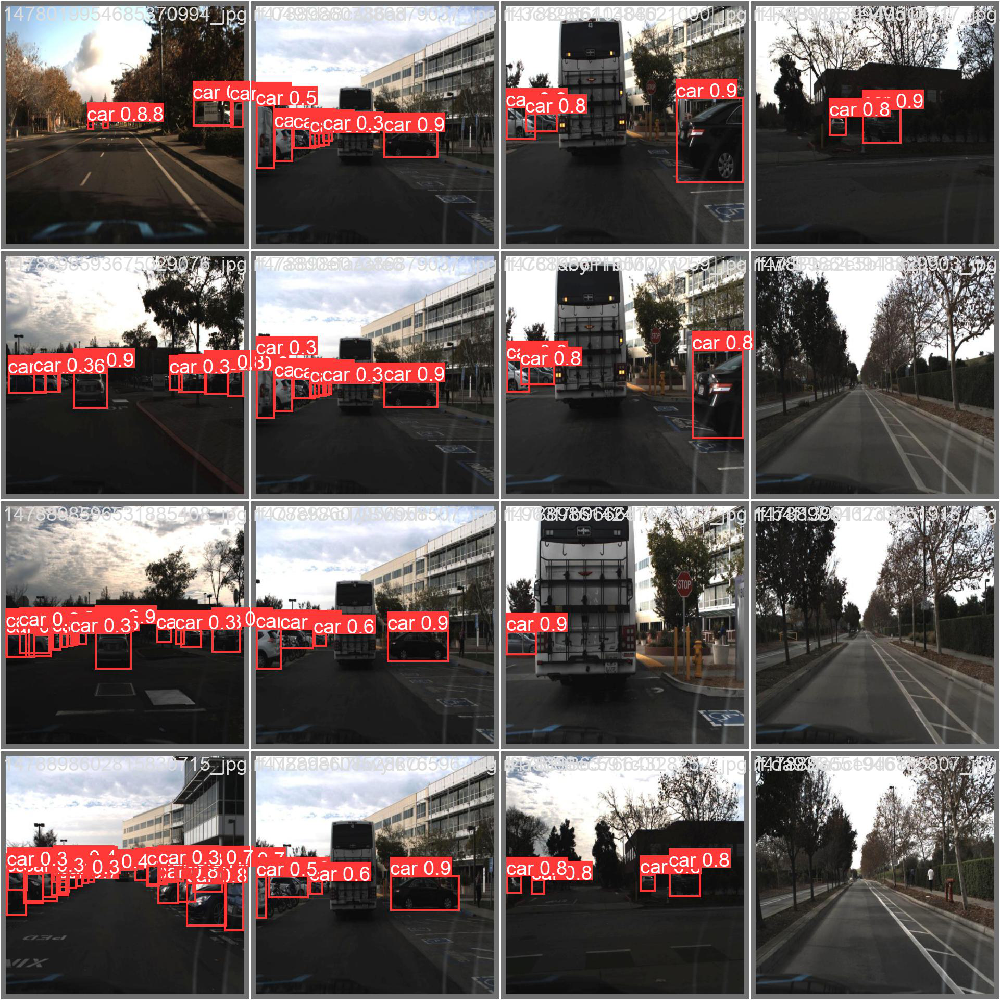

In [ ]:
#Display Validation Prediction Batch

val_batch0_pred = "val_batch0_pred.jpg"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

In [ ]:
# Run object detection on a single image using trained weights
!python detect.py --weights ./runs/train/exp/weights/best.pt --img-size 512 --conf 0.25 --source "./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg"

detect: weights=['./runs/train/exp/weights/best.pt'], source=./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg, data=data/coco128.yaml, imgsz=[512, 512], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5n summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs
image 1/1 /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg: 512x512 4 cars, 6.3ms
Speed: 0.4ms pre-process, 6.3ms inference, 1.5ms NMS per image at s

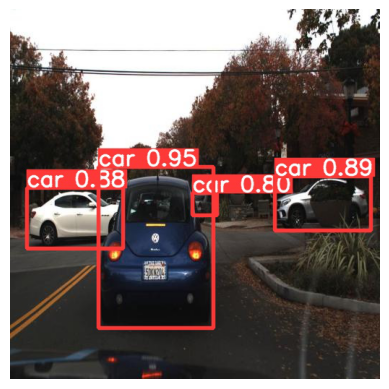

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

# Path to the detect folder
detect_folder = '/home/dll/Documents/obinna/yolov5/runs/detect/exp18'

# Name of the detected image file
detected_image_name = '1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg'

# Construct the full path to the detected image
detected_image_path = f'{detect_folder}/{detected_image_name}'

# Open and display the image
img = Image.open(detected_image_path)
plt.imshow(img)
plt.axis('off')
plt.show()


In [ ]:
#%load_ext tensorboard
#%tensorboard --logdir /home/dll/Documents/obinna/yolov5/runs/train/exp2

# Train further to improve performance

In [ ]:
!python train.py --data ./data/data1.yaml --epochs 100 --weights runs/train/exp/weights/best.pt --cfg yolov5n.yaml --batch-size 50

train: weights=runs/train/exp/weights/best.pt, cfg=yolov5n.yaml, data=./data/data1.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=50, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5,

In [ ]:
# Path to the results folder
results_folder = '/home/dll/Documents/obinna/yolov5/runs/train/exp2'

# List the contents of the folder
contents = os.listdir(results_folder)

# Display the list of all file names
print("Contents of the results folder:")
for item in contents:
    print(item)

Contents of the results folder:
F1_curve.png
val_batch0_pred.jpg
R_curve.png
train_batch1.jpg
train_batch0.jpg
opt.yaml
val_batch0_labels.jpg
results.png
labels.jpg
val_batch2_labels.jpg
hyp.yaml
results.csv
val_batch2_pred.jpg
val_batch1_labels.jpg
PR_curve.png
weights
P_curve.png
val_batch1_pred.jpg
events.out.tfevents.1694259462.dll-WS-C621E-SAGE-Series.3254337.0
confusion_matrix.png
labels_correlogram.jpg
train_batch2.jpg


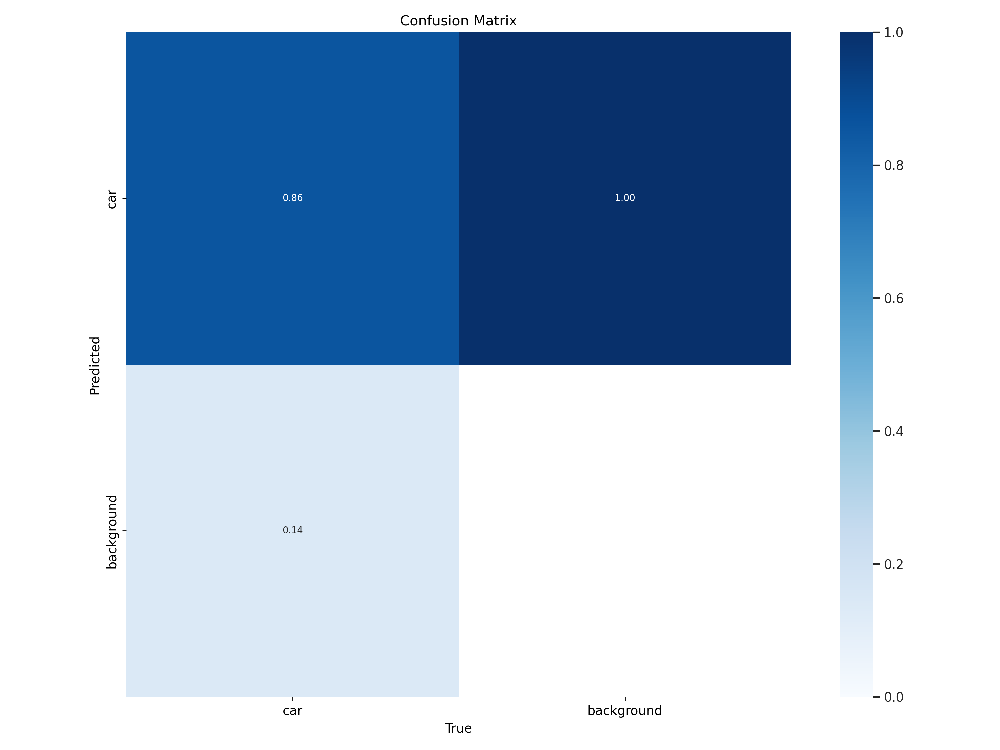

In [ ]:
from PIL import Image
from IPython.display import display

# Specify the path to the confusion matrix image
confusion_matrix_image = "confusion_matrix.png"
image_path = os.path.join(results_folder, confusion_matrix_image)

# Open and display the image
img = Image.open(image_path)
display(img)

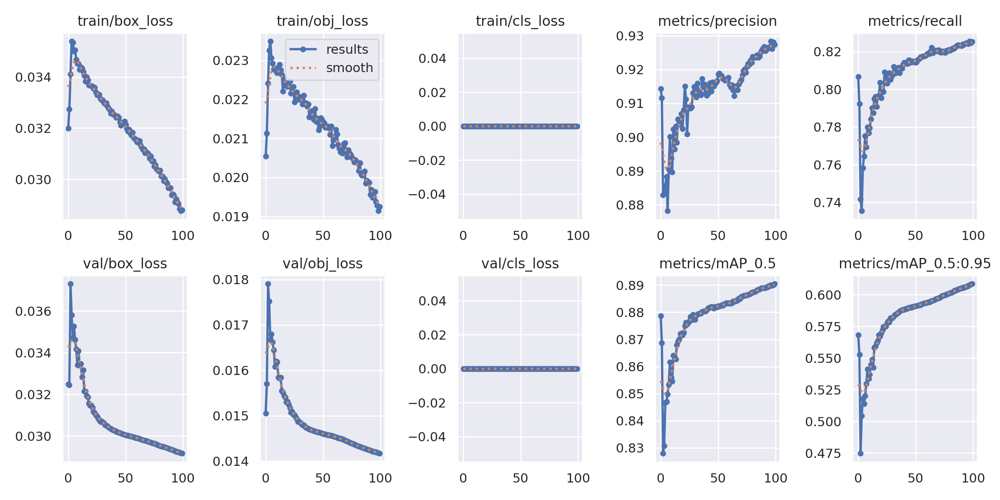

In [ ]:
#Training and Validation Loss

results = "results.png"
image_path = os.path.join(results_folder, results)
img = Image.open(image_path)
display(img)

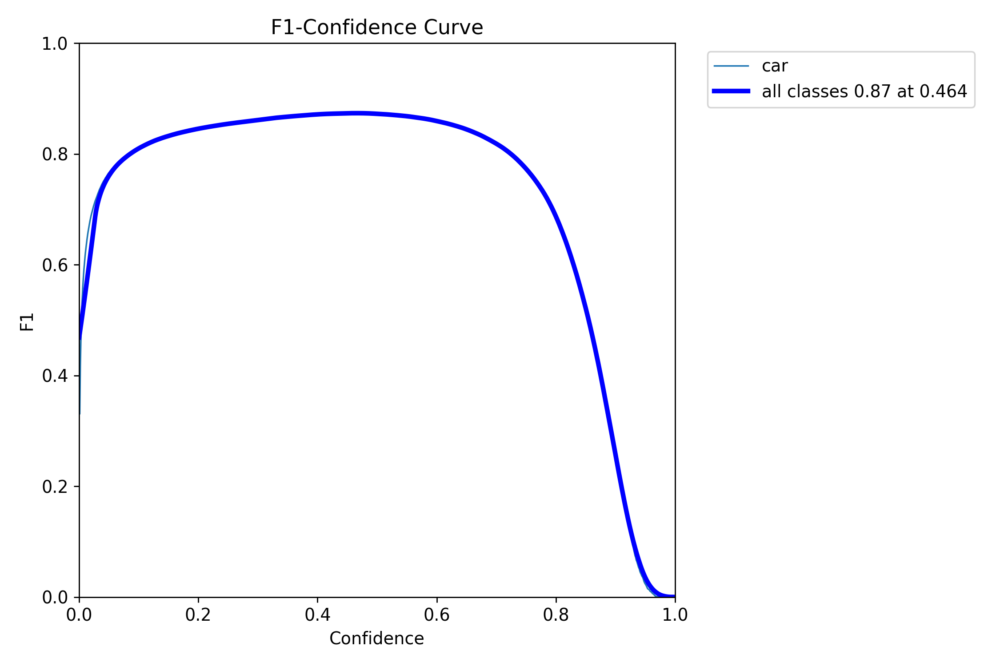

In [ ]:
#Display F1 Confidence curve

F1_curve = "F1_curve.png"
image_path = os.path.join(results_folder, F1_curve)
img = Image.open(image_path)
display(img)

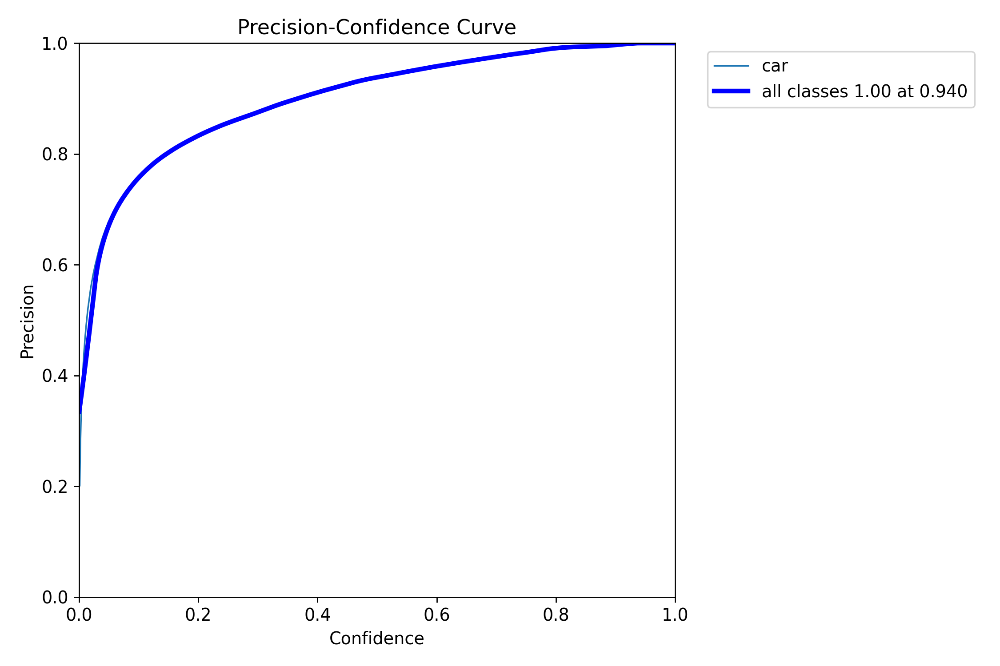

In [ ]:
#Display Validation Prediction Batch

val_batch0_pred = "P_curve.png"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

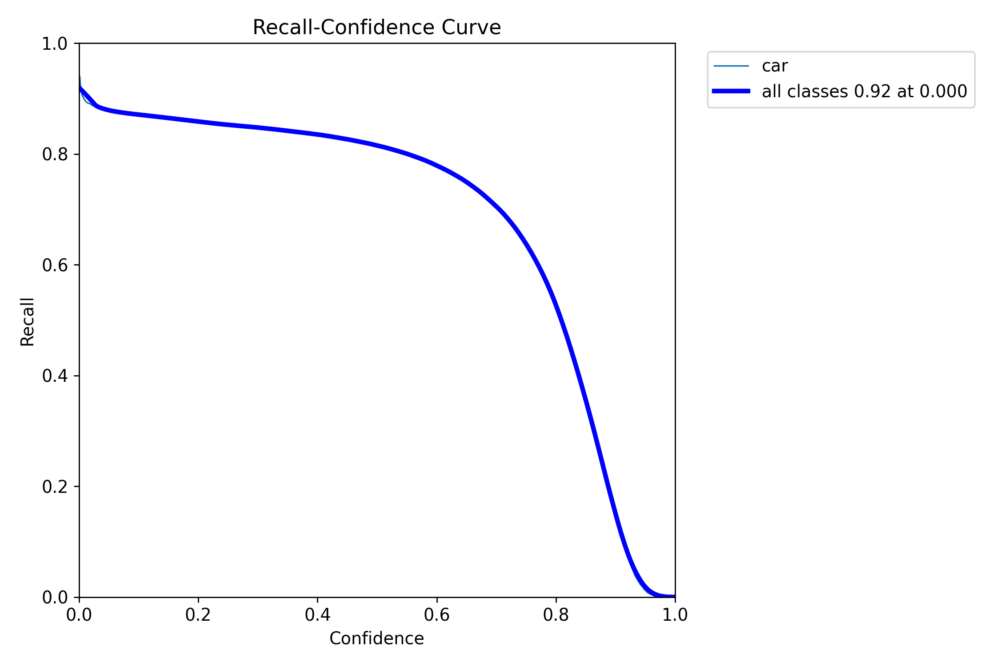

In [ ]:
#Display Validation Prediction Batch

val_batch0_pred = "R_curve.png"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

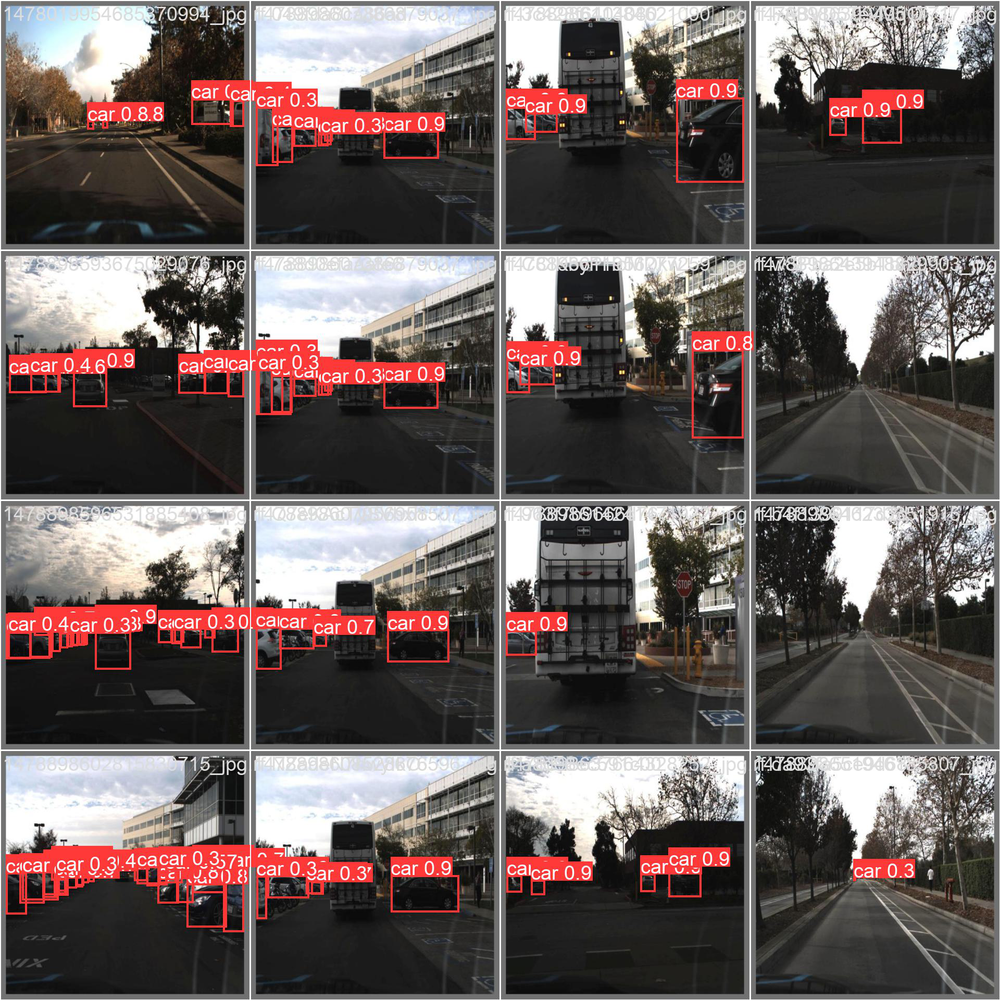

In [ ]:
#Display Validation Prediction Batch

val_batch0_pred = "val_batch0_pred.jpg"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

# Run Inference on a single image using trained weights

In [ ]:
# Run object detection on a single image using trained weights to be sure it works
!python detect.py --weights ./runs/train/exp2/weights/best.pt --img-size 512 --conf 0.25 --source "./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg"

detect: weights=['./runs/train/exp2/weights/best.pt'], source=./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg, data=data/coco128.yaml, imgsz=[512, 512], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5n summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs
image 1/1 /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg: 512x512 4 cars, 5.4ms
Speed: 0.4ms pre-process, 5.4ms inference, 1.3ms NMS per image at 

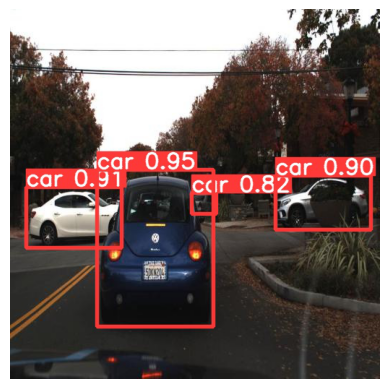

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

# Path to the detect folder
detect_folder = '/home/dll/Documents/obinna/yolov5/runs/detect/exp'

# Name of the detected image file
detected_image_name = '1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg'

# Construct the full path to the detected image
detected_image_path = f'{detect_folder}/{detected_image_name}'

# Open and display the image
img = Image.open(detected_image_path)
plt.imshow(img)
plt.axis('off')
plt.show()


# Tuning Parameters further to with different model architecture for better Performance

In [ ]:
!python train.py --data ./data/data1.yaml --epochs 100 --weights runs/train/exp2/weights/best.pt --cfg yolov5l.yaml --batch-size 50

train: weights=runs/train/exp2/weights/best.pt, cfg=yolov5l.yaml, data=./data/data1.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=50, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5

In [ ]:
# Path to the results folder
results_folder = '/home/dll/Documents/obinna/yolov5/runs/train/exp3'

# List the contents of the folder
contents = os.listdir(results_folder)

# Display the list of all file names
print("Contents of the results folder:")
for item in contents:
    print(item)

Contents of the results folder:
F1_curve.png
val_batch0_pred.jpg
R_curve.png
train_batch1.jpg
train_batch0.jpg
opt.yaml
val_batch0_labels.jpg
results.png
labels.jpg
val_batch2_labels.jpg
hyp.yaml
results.csv
val_batch2_pred.jpg
val_batch1_labels.jpg
PR_curve.png
weights
events.out.tfevents.1694276191.dll-WS-C621E-SAGE-Series.3470358.0
P_curve.png
val_batch1_pred.jpg
confusion_matrix.png
labels_correlogram.jpg
train_batch2.jpg


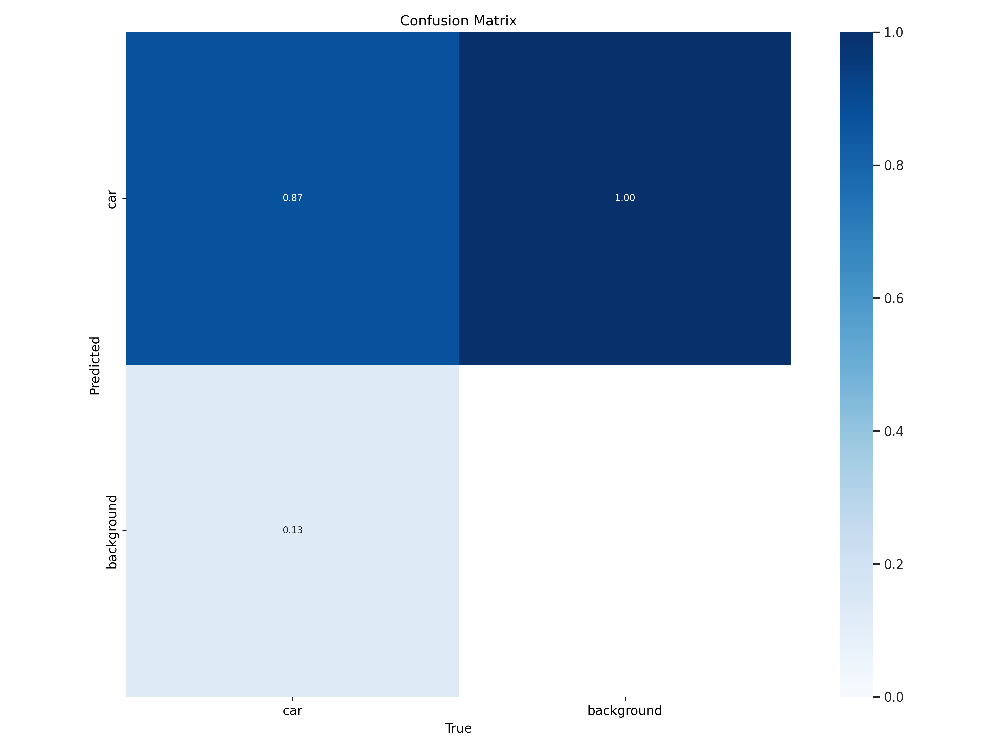

In [ ]:
from PIL import Image
from IPython.display import display

# Specify the path to the confusion matrix image
confusion_matrix_image = "confusion_matrix.png"
image_path = os.path.join(results_folder, confusion_matrix_image)

# Open and display the image
img = Image.open(image_path)
display(img)

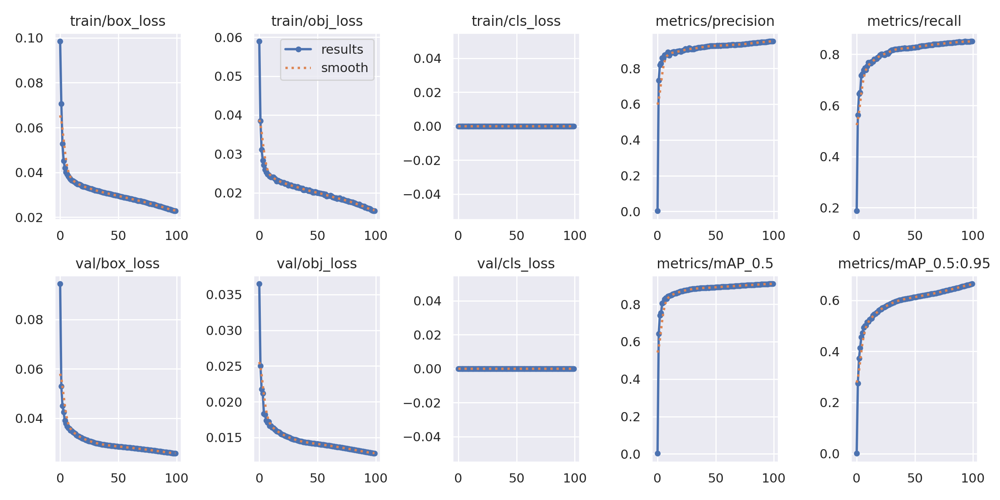

In [ ]:
#Training and Validation Loss

results = "results.png"  # Specify the image name you want to display
image_path = os.path.join(results_folder, results)
img = Image.open(image_path)
display(img)

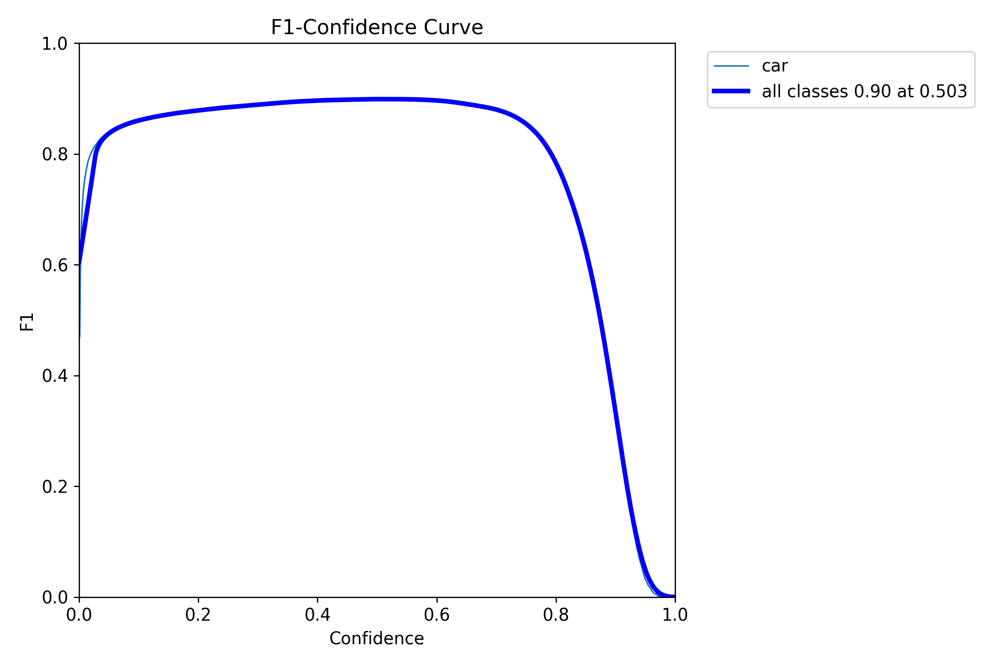

In [ ]:
#Display F1 Confidence curve

F1_curve = "F1_curve.png"
image_path = os.path.join(results_folder, F1_curve)
img = Image.open(image_path)
display(img)

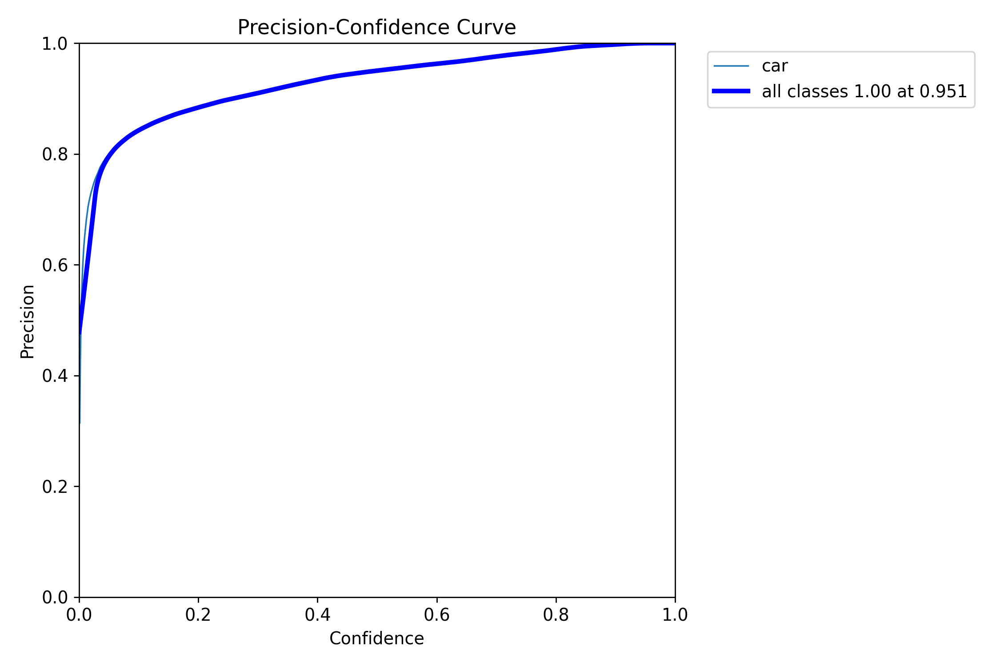

In [ ]:
#Display Precision Confidence curve

val_batch0_pred = "P_curve.png"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

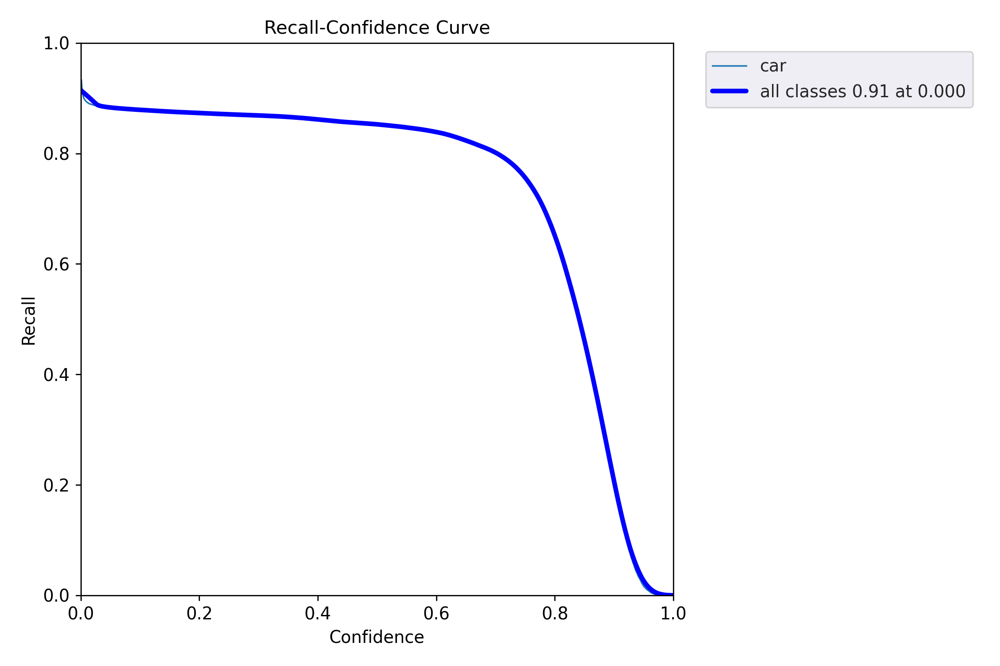

In [ ]:
#Display Recall Confidence curve

val_batch0_pred = "R_curve.png"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

# Run inference on the same image as before to check for Improvements

In [ ]:
# Run object detection on a single image using trained best weights to be sure it works
!python detect.py --weights ./runs/train/exp3/weights/best.pt --img-size 512 --conf 0.25 --source "./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg"

detect: weights=['./runs/train/exp3/weights/best.pt'], source=./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg, data=data/coco128.yaml, imgsz=[512, 512], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
image 1/1 /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg: 512x512 4 cars, 17.6ms
Speed: 0.5ms pre-process, 17.6ms inference, 2.0ms NMS per imag

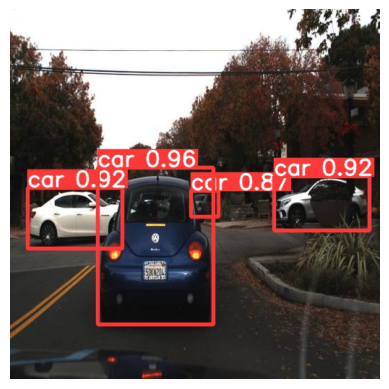

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

# Path to the detect folder
detect_folder = '/home/dll/Documents/obinna/yolov5/runs/detect/exp3'

# Name of the detected image file
detected_image_name = '1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg'

# Construct the full path to the detected image
detected_image_path = f'{detect_folder}/{detected_image_name}'

# Open and display the image
img = Image.open(detected_image_path)
plt.imshow(img)
plt.axis('off')
plt.show()


Significant Improvement observed

# Running Inference on a set of Randomly selected test images

detect: weights=['./runs/train/exp3/weights/best.pt'], source=./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478897480231516960_jpg.rf.26f35608b8be4358e50b3651ebad3926.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
image 1/1 /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478897480231516960_jpg.rf.26f35608b8be4358e50b3651ebad3926.jpg: 640x640 8 cars, 15.5ms
Speed: 0.6ms pre-process, 15.5ms infer

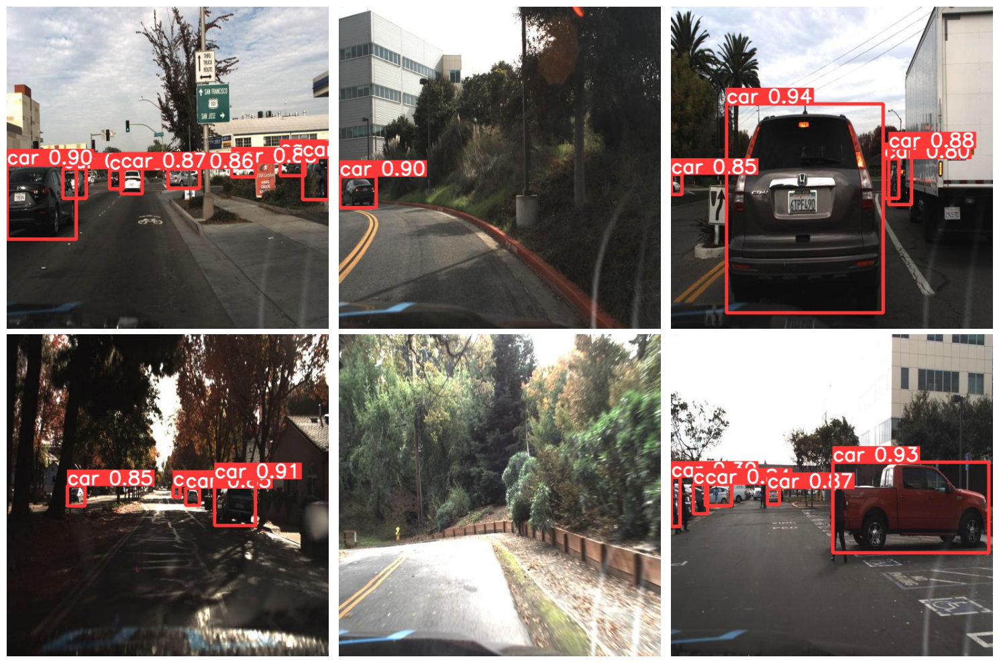

In [ ]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

# Path to the test images folder
test_folder = './Self Driving Car.v3-fixed-small.yolov8/export/test/images'

# List all image files in the test folder
image_files = [f for f in os.listdir(test_folder) if f.endswith('.jpg')]

# Randomly select 6 images
random_images = random.sample(image_files, 6)

# Inference command
inference_command = "python detect.py --weights ./runs/train/exp3/weights/best.pt --img-size 640 --conf 0.25"

# Create a 2x3 grid for displaying images
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Iterate over the randomly selected image files and perform inference
for i, image_file in enumerate(random_images):
    row, col = divmod(i, 3)  # Calculate row and column indices
    image_path = os.path.join(test_folder, image_file)
    full_command = f"{inference_command} --source '{image_path}'"
    os.system(full_command)

    # Path to the detect folder
    detect_folder = './runs/detect'

    # List all 'exp' folders in the 'detect' folder with valid numeric names
    exp_folders = [f for f in os.listdir(detect_folder) if f.startswith('exp') and f[3:].isdigit()]

    # Get the path to the latest 'exp' folder
    latest_exp_folder = sorted(exp_folders, key=lambda x: int(x[3:]), reverse=True)[0]

    exp_path = os.path.join(detect_folder, latest_exp_folder)

    # List all image files in the 'exp' folder
    exp_image_files = [f for f in os.listdir(exp_path) if f.endswith('.jpg')]

    # Get the latest detected image
    detected_image_file = sorted(exp_image_files, key=lambda x: int(x.split('_')[0]))[-1]

    detected_image_path = os.path.join(exp_path, detected_image_file)

    # Open and display the detected image in the corresponding subplot
    img = Image.open(detected_image_path)
    axes[row, col].imshow(img)
    axes[row, col].axis('off')

# Show the figure with all images displayed in a 2x3 grid
plt.tight_layout()
plt.show()


# Validate Custom Model

In [ ]:
!python /home/dll/Documents/obinna/yolov5/val.py --task val --data /home/dll/Documents/obinna/yolov5/val1.yaml --weights /home/dll/Documents/obinna/yolov5/runs/train/exp3/weights/best.pt

val: data=/home/dll/Documents/obinna/yolov5/val1.yaml, weights=['/home/dll/Documents/obinna/yolov5/runs/train/exp3/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=Documents/obinna/yolov5/runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
val: Scanning /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.
val: WARNING ⚠️ /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/valid/images/1478021875081281646_jpg.rf.e9552980cf8c6fef4aa02cb84c6364f5.jpg: 1 duplicate labels removed
val: WARNING ⚠️ /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yol

In [ ]:
import os

# Define the directory path you want to change to
new_directory = '/home/dll/Documents/obinna/yolov5/'

# Change the current working directory
os.chdir(new_directory)

# Fine Tune the parameters further for increased performance

In [ ]:
!python train.py --data ./data/data1.yaml --epochs 120 --weights runs/train/exp3/weights/best.pt --cfg yolov5l.yaml --batch-size 50

train: weights=runs/train/exp3/weights/best.pt, cfg=yolov5l.yaml, data=./data/data1.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=120, batch_size=50, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 14, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 14 (delta 5), reused 12 (delta 5), pack-reused 0
Unpacking objects: 100% (14/14), done.
From https://github.com/ultralytics/yolov5
   a6659d0..ec690e4  master     -> origin/master
github: ⚠️ YOLOv5 is out of date by 6 commits. 

In [ ]:
# Path to the results folder
results_folder = '/home/dll/Documents/obinna/yolov5/runs/train/exp4'

# List the contents of the folder
contents = os.listdir(results_folder)

# Display the list of all file names
print("Contents of the results folder:")
for item in contents:
    print(item)


Contents of the results folder:
F1_curve.png
val_batch0_pred.jpg
R_curve.png
train_batch1.jpg
train_batch0.jpg
opt.yaml
val_batch0_labels.jpg
results.png
labels.jpg
val_batch2_labels.jpg
hyp.yaml
results.csv
val_batch2_pred.jpg
val_batch1_labels.jpg
PR_curve.png
weights
P_curve.png
val_batch1_pred.jpg
confusion_matrix.png
labels_correlogram.jpg
train_batch2.jpg
events.out.tfevents.1694368169.dll-WS-C621E-SAGE-Series.1290405.0


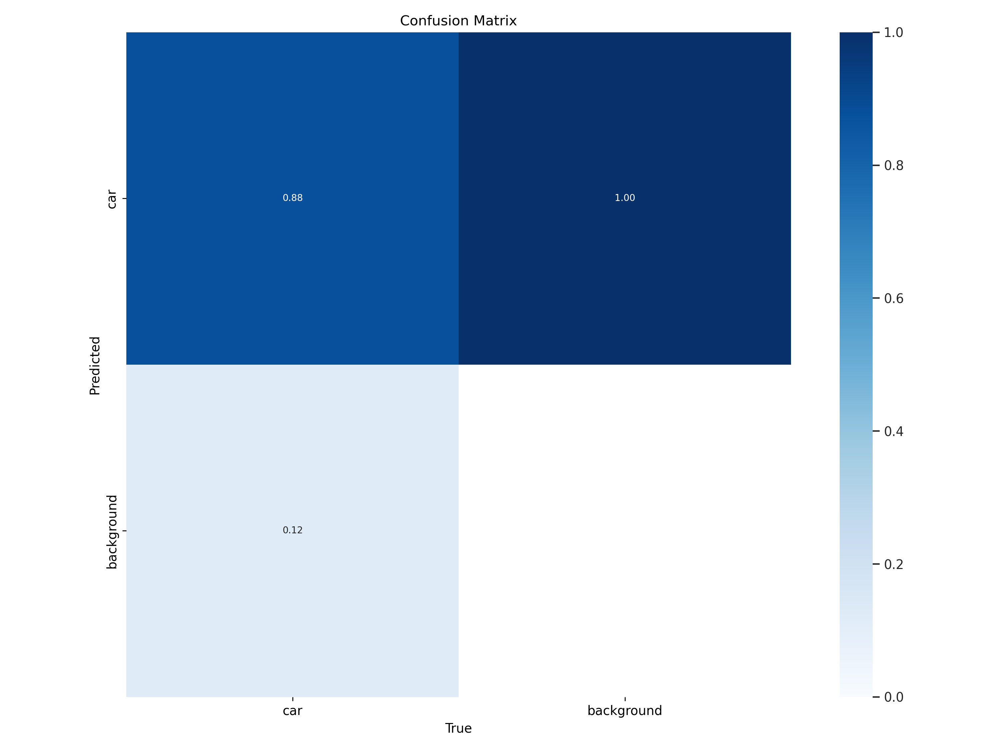

In [ ]:
from PIL import Image
from IPython.display import display

# Specify the path to the confusion matrix image
confusion_matrix_image = "confusion_matrix.png"
image_path = os.path.join(results_folder, confusion_matrix_image)

# Open and display the image
img = Image.open(image_path)
display(img)

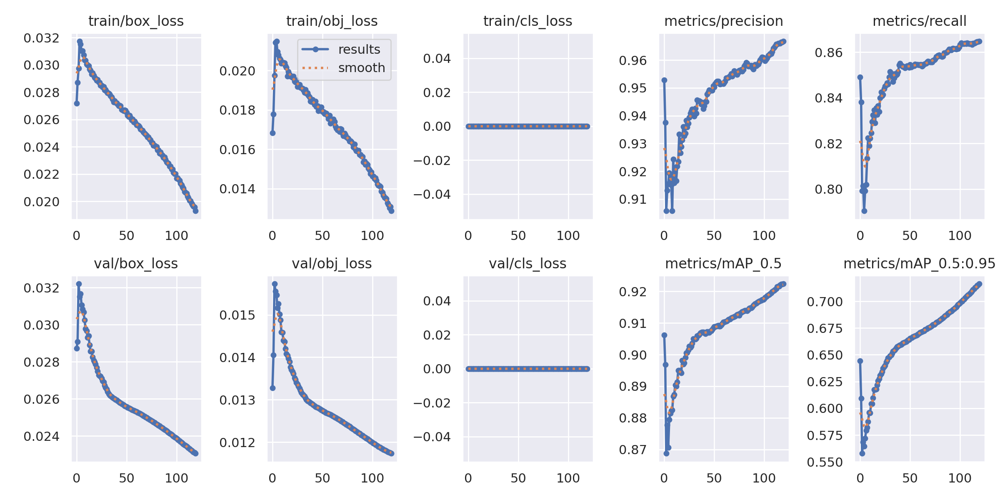

In [ ]:
#Training and Validation Loss

results = "results.png"  # Specify the image name you want to display
image_path = os.path.join(results_folder, results)
img = Image.open(image_path)
display(img)

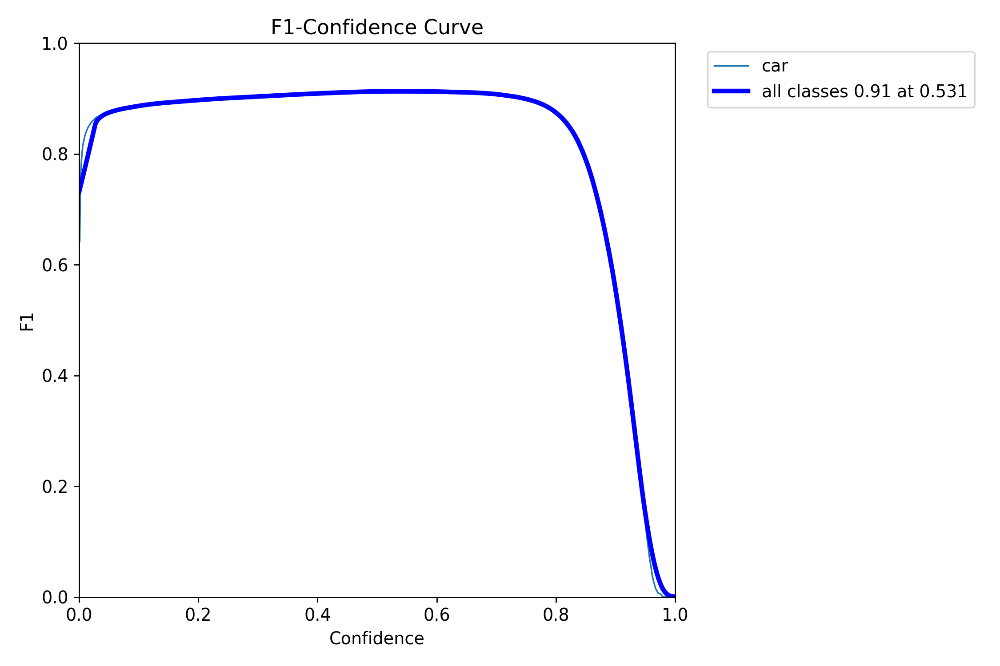

In [ ]:
#Display F1 Confidence curve

F1_curve = "F1_curve.png"
image_path = os.path.join(results_folder, F1_curve)
img = Image.open(image_path)
display(img)

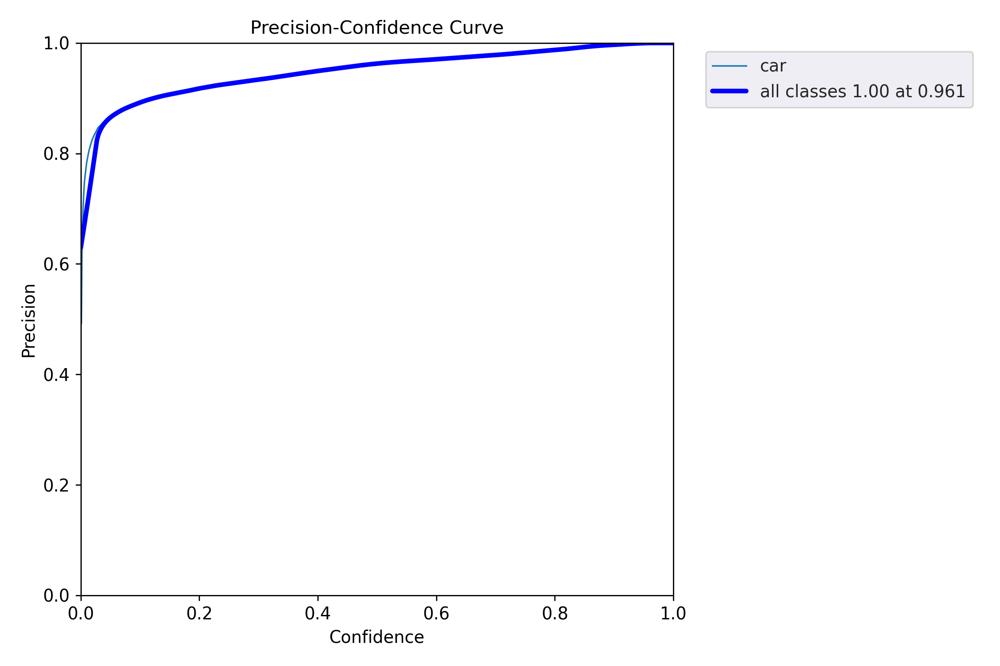

In [ ]:
#Display Precision Confidence curve

val_batch0_pred = "P_curve.png"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

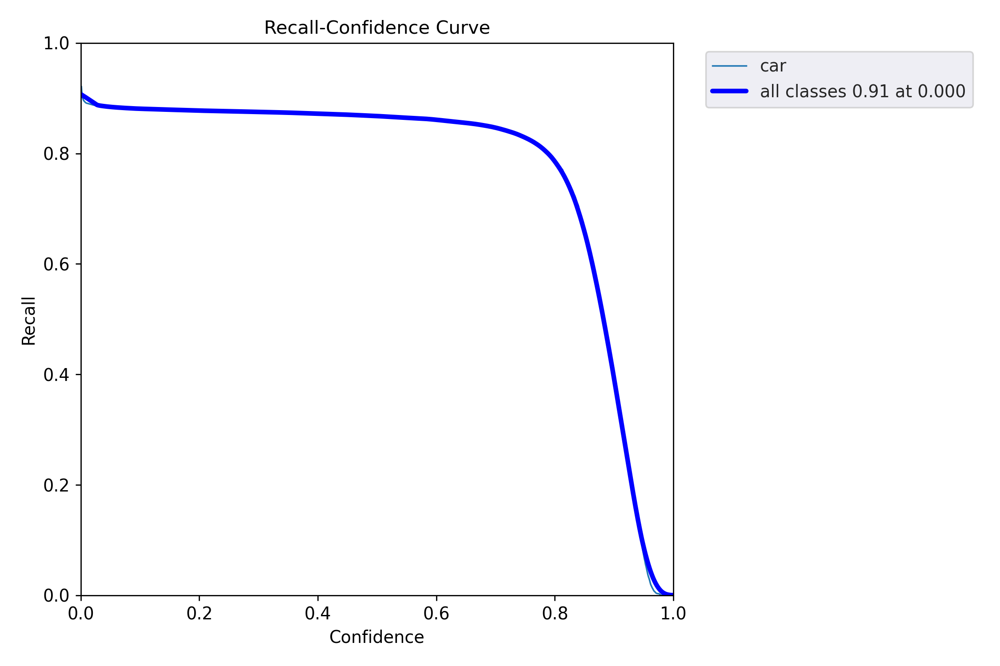

In [ ]:
#Display Recall Confidence curve

val_batch0_pred = "R_curve.png"
image_path = os.path.join(results_folder, val_batch0_pred)
img = Image.open(image_path)
display(img)

# Run inference on the same image as before to check for Improvements

In [ ]:
# Run object detection on a single image using trained best weights to be sure it works
!python detect.py --weights ./runs/train/exp4/weights/best.pt --img-size 512 --conf 0.25 --source "./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg"

detect: weights=['./runs/train/exp4/weights/best.pt'], source=./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg, data=data/coco128.yaml, imgsz=[512, 512], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
image 1/1 /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg: 512x512 4 cars, 19.7ms
Speed: 0.7ms pre-process, 19.7ms inference, 3.0ms NMS per imag

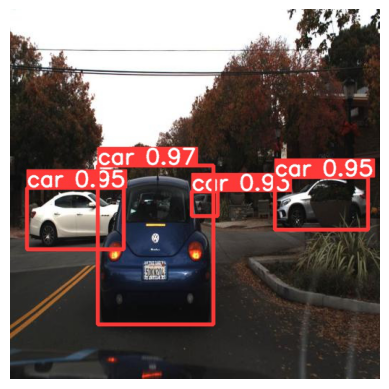

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

# Path to the detect folder
detect_folder = '/home/dll/Documents/obinna/yolov5/runs/detect/exp11'

# Name of the detected image file
detected_image_name = '1478900870836474260_jpg.rf.9Rb97strMADzIANCBdw4.jpg'

# Construct the full path to the detected image
detected_image_path = f'{detect_folder}/{detected_image_name}'

# Open and display the image
img = Image.open(detected_image_path)
plt.imshow(img)
plt.axis('off')
plt.show()

A lot of improvement observed

# Running Inference on a set of Randomly selected test images

detect: weights=['./runs/train/exp4/weights/best.pt'], source=./Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478899624852778116_jpg.rf.3a9122291cd507068544f7257afb0d4f.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
image 1/1 /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/test/images/1478899624852778116_jpg.rf.3a9122291cd507068544f7257afb0d4f.jpg: 640x640 7 cars, 23.0ms
Speed: 0.7ms pre-process, 23.0ms infer

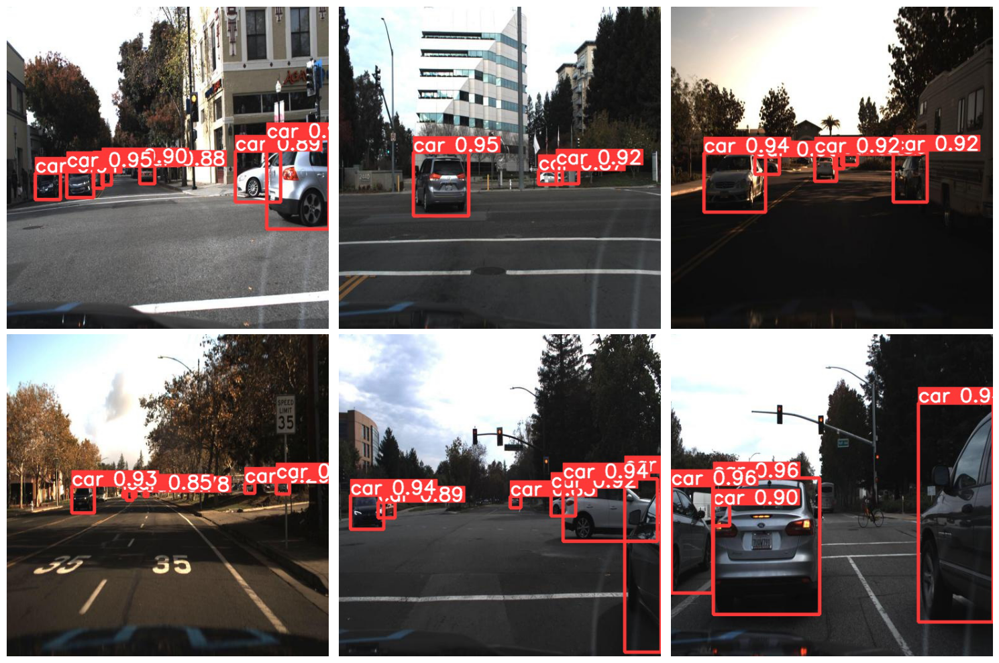

In [ ]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

# Path to the test images folder
test_folder = './Self Driving Car.v3-fixed-small.yolov8/export/test/images'

# List all image files in the test folder
image_files = [f for f in os.listdir(test_folder) if f.endswith('.jpg')]

# Randomly select 6 images
random_images = random.sample(image_files, 6)

# Inference command
inference_command = "python detect.py --weights ./runs/train/exp4/weights/best.pt --img-size 640 --conf 0.25"

# Create a 2x3 grid for displaying images
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Iterate over the randomly selected image files and perform inference
for i, image_file in enumerate(random_images):
    row, col = divmod(i, 3)  # Calculate row and column indices
    image_path = os.path.join(test_folder, image_file)
    full_command = f"{inference_command} --source '{image_path}'"
    os.system(full_command)

    # Path to the detect folder
    detect_folder = './runs/detect'

    # List all 'exp' folders in the 'detect' folder with valid numeric names
    exp_folders = [f for f in os.listdir(detect_folder) if f.startswith('exp') and f[3:].isdigit()]

    # Get the path to the latest 'exp' folder
    latest_exp_folder = sorted(exp_folders, key=lambda x: int(x[3:]), reverse=True)[0]

    exp_path = os.path.join(detect_folder, latest_exp_folder)

    # List all image files in the 'exp' folder
    exp_image_files = [f for f in os.listdir(exp_path) if f.endswith('.jpg')]

    # Get the latest detected image
    detected_image_file = sorted(exp_image_files, key=lambda x: int(x.split('_')[0]))[-1]

    detected_image_path = os.path.join(exp_path, detected_image_file)

    # Open and display the detected image in the corresponding subplot
    img = Image.open(detected_image_path)
    axes[row, col].imshow(img)
    axes[row, col].axis('off')

# Show the figure with all images displayed in a 2x3 grid
plt.tight_layout()
plt.show()

# Run Inference on Video

In [ ]:
# Run object detection on a single Video using trained weights

!python detect.py --weights ./runs/train/exp4/weights/best.pt --img-size 512 --conf 0.25 --source "./Self Driving Car.v3-fixed-small.yolov8/export/cars_moving.mp4"

detect: weights=['./runs/train/exp4/weights/best.pt'], source=./Self Driving Car.v3-fixed-small.yolov8/export/cars_moving.mp4, data=data/coco128.yaml, imgsz=[512, 512], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
video 1/1 (1/301) /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/cars_moving.mp4: 288x512 3 cars, 15.6ms
video 1/1 (2/301) /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/cars_moving.mp4: 288x512 4 cars, 10.9ms
video 1/1 (3

# Display Video Result as GIF

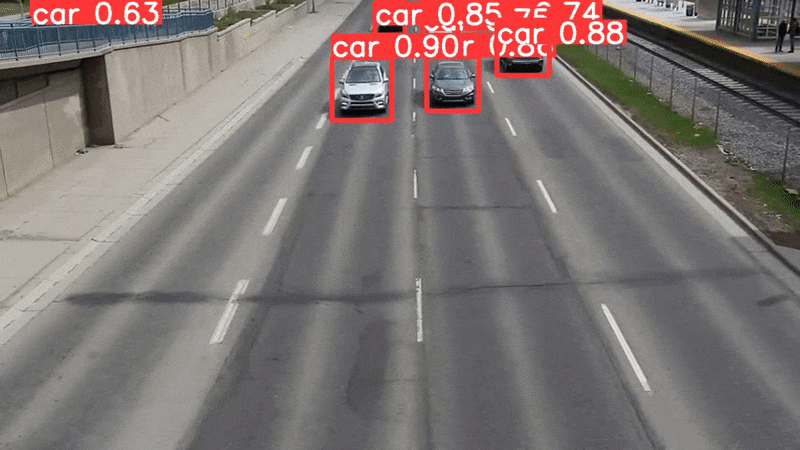

In [ ]:
from IPython.display import Image, display

# Specify the path to your GIF file
gif_path = '/home/dll/Documents/obinna/yolov5/runs/detect/exp19/detect1.gif'

# Display the GIF
display(Image(filename=gif_path))

# Validate Custom Model

In [ ]:
!python /home/dll/Documents/obinna/yolov5/val.py --task val --data /home/dll/Documents/obinna/yolov5/val1.yaml --weights /home/dll/Documents/obinna/yolov5/runs/train/exp4/weights/best.pt

val: data=/home/dll/Documents/obinna/yolov5/val1.yaml, weights=['/home/dll/Documents/obinna/yolov5/runs/train/exp4/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-210-gdd10481 Python-3.8.5 torch-1.10.0+cu113 CUDA:0 (NVIDIA RTX A6000, 48685MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
val: Scanning /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.
val: WARNING ⚠️ /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/valid/images/1478021875081281646_jpg.rf.e9552980cf8c6fef4aa02cb84c6364f5.jpg: 1 duplicate labels removed
val: WARNING ⚠️ /home/dll/Documents/obinna/yolov5/Self Driving Car.v3-fixed-small.yolov8/export/valid/images/